In [37]:
import numpy as np
import pandas as pd
import rdkit
from rdkit import Chem
import networkx as nx

In [38]:
df = pd.read_csv('data/train.csv')
df = df.drop(['Kd (nM)', 'Ki (nM)', 'IC50 (nM)', 'EC50 (nM)'], axis=1)
df = df.dropna()
df = df[~df.isin(['5&#39;-CTGGGTGGGAACTCAAAGTCCGGCTTTGTCGTTA-3&#39;', '[I-]','[Cl-]', '[Br-]', '[SH-]', '[F-]']).any(axis=1)]
drugs_train, protein_train, binding_train = list(df['SMILES']), list(df['protein_sequence']), list(df['Binding affinity'])
print(len(drugs_train))

df = pd.read_csv('data/test.csv')
df = df.drop(['Kd (nM)', 'Ki (nM)', 'IC50 (nM)', 'EC50 (nM)'], axis=1)
df = df.dropna()
df = df[~df.isin(['5&#39;-CTGGGTGGGAACTCAAAGTCCGGCTTTGTCGTTA-3&#39;', '[I-]','[Cl-]', '[Br-]', '[SH-]', '[F-]']).any(axis=1)]
drugs_test, protein_test, binding_test = list(df['SMILES']), list(df['protein_sequence']), list(df['Binding affinity'])
print(len(drugs_test))

62697
15700


In [39]:
max_len = 1000
amino_acids = 'ABCDEFGHIJKLMNOPQRSTUVWXYZ'
aa_to_index = {aa: idx for idx, aa in enumerate(amino_acids)}

def encode_protein(protein):
    protein = protein.upper().replace('\n', '').replace(' ', '')
    encoded = np.zeros(max_len)
    for i, ch in enumerate(protein[:max_len]):
        encoded[i] = aa_to_index[ch]
    return encoded

In [40]:
encoded_protein = [encode_protein(protein) for protein in protein_train]
drugs_train, protein_train, binding_train = np.asarray(drugs_train), np.asarray(encoded_protein), np.asarray(binding_train)

encoded_protein = [encode_protein(protein) for protein in protein_test]
drugs_test, protein_test, binding_test = np.asarray(drugs_test), np.asarray(encoded_protein), np.asarray(binding_test)

In [41]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
binding_train = scaler.fit_transform(binding_train.reshape(-1, 1))
binding_test = scaler.fit_transform(binding_test.reshape(-1, 1))




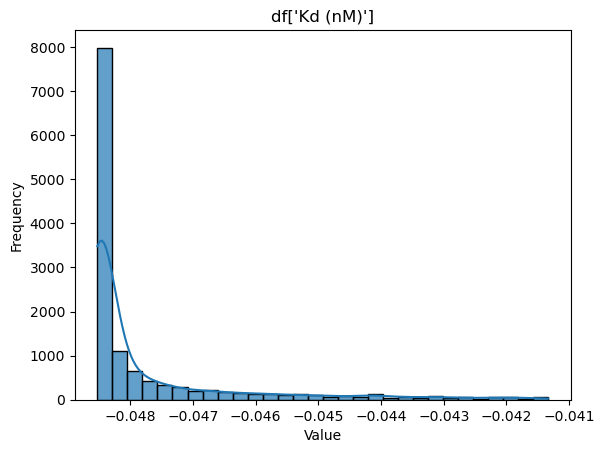

In [45]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

data = binding_test

# Step 1: Calculate IQR
Q1 = np.percentile(data, 25)  # 25th percentile (Q1)
Q3 = np.percentile(data, 75)  # 75th percentile (Q3)
IQR = Q3 - Q1

# Define the lower and upper bounds to exclude outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Step 2: Filter the data
filtered_data = data[(data >= lower_bound) & (data <= upper_bound)]

# Step 3: Plot the histogram without outliers
sns.histplot(filtered_data, kde=True, bins=30, alpha=0.7)
plt.title("df['Kd (nM)']")
plt.xlabel("Value")
plt.ylabel("Frequency")
plt.show()

In [47]:
print(binding_train.min(), binding_train.max())
print(binding_test.min(), binding_test.max())

-0.02722155597787123 137.77276750133228
-0.04852555208549646 52.62710927587625


In [46]:
np.max(binding_test)

52.62710927587625

### Preparing dataset in pytorch format

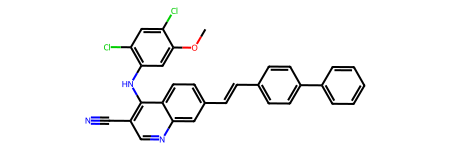

In [26]:
mol = Chem.MolFromSmiles(drugs_train[0])
mol

In [27]:
# Node features 1
def atom_features(atom):
    return np.array(one_of_k_encoding_unk(atom.GetSymbol(),['C', 'N', 'O', 'S', 'F', 'Si', 'P', 'Cl', 'Br', 'Mg', 'Na','Ca', 'Fe', 'As', 'Al', 'I', 'B', 'V', 'K', 'Tl', 'Yb','Sb', 'Sn', 'Ag', 'Pd', 'Co', 'Se', 'Ti', 'Zn', 'H','Li', 'Ge', 'Cu', 'Au', 'Ni', 'Cd', 'In', 'Mn', 'Zr','Cr', 'Pt', 'Hg', 'Pb', 'Unknown']) +
                    one_of_k_encoding(atom.GetDegree(), [0, 1, 2, 3, 4, 5, 6,7,8,9,10]) +
                    one_of_k_encoding_unk(atom.GetTotalNumHs(), [0, 1, 2, 3, 4, 5, 6,7,8,9,10]) +
                    one_of_k_encoding_unk(atom.GetImplicitValence(), [0, 1, 2, 3, 4, 5, 6,7,8,9,10]) +
                    [atom.GetIsAromatic()])

def one_of_k_encoding(x, allowable_set):
    if x not in allowable_set:
        raise Exception("input {0} not in allowable set{1}:".format(x, allowable_set))
    return list(map(lambda s: x == s, allowable_set))

def one_of_k_encoding_unk(x, allowable_set):
    """Maps inputs not in the allowable set to the last element."""
    if x not in allowable_set:
        x = allowable_set[-1]
    return list(map(lambda s: x == s, allowable_set))

In [28]:
def prepare_graph_from_smiles(smile):
    mol = Chem.MolFromSmiles(smile)

    no_of_atoms = mol.GetNumAtoms()

    node_features = []
    for atom in mol.GetAtoms():
        feature = atom_features(atom)
        node_features.append( feature / sum(feature) )


    edges = [[bond.GetBeginAtomIdx(), bond.GetEndAtomIdx()] for bond in mol.GetBonds()]
    g = nx.Graph(edges).to_directed()

    edge_indices = [[e1, e2] for e1, e2 in g.edges]
    
    return no_of_atoms, node_features, edge_indices

for smile in drugs_train:
    prepare_graph_from_smiles(smile)

In [29]:
smile_graph = {}
for smile in drugs_train:
    g = prepare_graph_from_smiles(smile)
    smile_graph[smile] = g

[21:24:18] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:24:19] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:24:22] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:24:28] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:24:32] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:24:35] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:24:46] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:24:48] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:24:51] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:24:53] WARNING: not removing hydrogen atom with neighbor that has non-tetrahed

In [30]:
len(smile_graph)

37699

In [31]:
smile_graph_test = {}
for smile in drugs_test:
    g = prepare_graph_from_smiles(smile)
    smile_graph_test[smile] = g

len(smile_graph_test)

[21:25:48] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:25:51] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:25:53] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry
[21:25:57] WARNING: not removing hydrogen atom with neighbor that has non-tetrahedral stereochemistry


13010

In [32]:
smile_graph.update(smile_graph_test)
len(smile_graph)

43276

In [33]:
smile_graph

{'COc1cc(Nc2c(C#N)cnc3cc(/C=C/c4ccc(-c5ccccc5)cc4)ccc23)c(Cl)cc1Cl': (37,
  [array([0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  , 0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  , 0.  , 0.  , 0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  , 0.  , 0.  , 0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  ]),
   array([0.  , 0.  , 0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  ,
          0.  , 0.  , 0.25, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.

### We have 
- drugs_train, protein_train, binding_train 
- drugs_test, protein_test, binding_test

train_data = TestbedDataset(root='data', dataset=dataset+'_train', xd=train_drugs, xt=train_prots, y=train_Y,smile_graph=smile_graph)

In [34]:
import os
from torch_geometric.data import InMemoryDataset, DataLoader
from torch_geometric import data as DATA
import torch

class TestbedDataset(InMemoryDataset):
    def __init__(self, root='/tmp', dataset='bindingDB', 
                 xd=None, xt=None, y=None, transform=None,
                 pre_transform=None,smile_graph=None):

        #root is required for save preprocessed data, default is '/tmp'
        super(TestbedDataset, self).__init__(root, transform, pre_transform)
        # benchmark dataset, default = 'davis'
        self.dataset = dataset
        print(self.processed_paths)
        if os.path.isfile(self.processed_paths[0]):
            print('Pre-processed data found: {}, loading ...'.format(self.processed_paths[0]))
            self.data, self.slices = torch.load(self.processed_paths[0])
        else:
            print('Pre-processed data {} not found, doing pre-processing...'.format(self.processed_paths[0]))
            self.process(xd, xt, y,smile_graph)
            self.data, self.slices = torch.load(self.processed_paths[0])
    @property
    def raw_file_names(self):
        pass
        #return ['some_file_1', 'some_file_2', ...]

    @property
    def processed_file_names(self):
        return [self.dataset + '.pt']

    def download(self):
        # Download to `self.raw_dir`.
        pass

    def _download(self):
        pass

    def _process(self):
        if not os.path.exists(self.processed_dir):
            os.makedirs(self.processed_dir)

    # Customize the process method to fit the task of drug-target affinity prediction
    # Inputs:
    # XD - list of SMILES, XT: list of encoded target (categorical or one-hot),
    # Y: list of labels (i.e. affinity)
    # Return: PyTorch-Geometric format processed data
    def process(self, xd, xt, y,smile_graph):
        assert (len(xd) == len(xt) and len(xt) == len(y)), "The three lists must be the same length!"
        data_list = []
        data_len = len(xd)
        for i in range(data_len):
            print('Converting SMILES to graph: {}/{}'.format(i+1, data_len))
            smiles = xd[i]
            target = xt[i]
            labels = y[i]
            # convert SMILES to molecular representation using rdkit
            c_size, features, edge_index = smile_graph[smiles]
            # make the graph ready for PyTorch Geometrics GCN algorithms:
            GCNData = DATA.Data(x=torch.Tensor(features),
                                edge_index=torch.LongTensor(edge_index).transpose(1, 0),
                                y=torch.FloatTensor([labels]))
            GCNData.target = torch.LongTensor([target])
            GCNData.__setitem__('c_size', torch.LongTensor([c_size]))
            # append graph, label and target sequence to data list
            data_list.append(GCNData)

        if self.pre_filter is not None:
            data_list = [data for data in data_list if self.pre_filter(data)]

        if self.pre_transform is not None:
            data_list = [self.pre_transform(data) for data in data_list]
        print('Graph construction done. Saving to file.')
        data, slices = self.collate(data_list)
        # save preprocessed data:
        torch.save((data, slices), self.processed_paths[0])

In [35]:
train_data = TestbedDataset(root='data', 
                            dataset='bindingDB_train', 
                            xd=drugs_train, 
                            xt=protein_train, 
                            y=binding_train,
                            smile_graph=smile_graph)

['data/processed/bindingDB_train.pt']
Pre-processed data data/processed/bindingDB_train.pt not found, doing pre-processing...
Converting SMILES to graph: 1/62697
Converting SMILES to graph: 2/62697
Converting SMILES to graph: 3/62697
Converting SMILES to graph: 4/62697
Converting SMILES to graph: 5/62697
Converting SMILES to graph: 6/62697
Converting SMILES to graph: 7/62697
Converting SMILES to graph: 8/62697
Converting SMILES to graph: 9/62697
Converting SMILES to graph: 10/62697
Converting SMILES to graph: 11/62697
Converting SMILES to graph: 12/62697
Converting SMILES to graph: 13/62697
Converting SMILES to graph: 14/62697
Converting SMILES to graph: 15/62697
Converting SMILES to graph: 16/62697
Converting SMILES to graph: 17/62697
Converting SMILES to graph: 18/62697
Converting SMILES to graph: 19/62697
Converting SMILES to graph: 20/62697
Converting SMILES to graph: 21/62697
Converting SMILES to graph: 22/62697
Converting SMILES to graph: 23/62697
Converting SMILES to graph: 24/6

In [36]:
test_data = TestbedDataset(root='data', 
                            dataset='bindingDB_test', 
                            xd=drugs_test, 
                            xt=protein_test, 
                            y=binding_test,
                            smile_graph=smile_graph)

['data/processed/bindingDB_test.pt']
Pre-processed data data/processed/bindingDB_test.pt not found, doing pre-processing...
Converting SMILES to graph: 1/15700
Converting SMILES to graph: 2/15700
Converting SMILES to graph: 3/15700
Converting SMILES to graph: 4/15700
Converting SMILES to graph: 5/15700
Converting SMILES to graph: 6/15700
Converting SMILES to graph: 7/15700
Converting SMILES to graph: 8/15700
Converting SMILES to graph: 9/15700
Converting SMILES to graph: 10/15700
Converting SMILES to graph: 11/15700
Converting SMILES to graph: 12/15700
Converting SMILES to graph: 13/15700
Converting SMILES to graph: 14/15700
Converting SMILES to graph: 15/15700
Converting SMILES to graph: 16/15700
Converting SMILES to graph: 17/15700
Converting SMILES to graph: 18/15700
Converting SMILES to graph: 19/15700
Converting SMILES to graph: 20/15700
Converting SMILES to graph: 21/15700
Converting SMILES to graph: 22/15700
Converting SMILES to graph: 23/15700
Converting SMILES to graph: 24/157